### Import Packages

In [1]:
# --> Import packages
from sportsipy.ncaab.teams import Team
from sportsipy.ncaab.teams import Teams # Sports Reference API
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from sklearn.feature_selection import SelectFromModel
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

C:\Users\Robby\anaconda3\lib\site-packages\requests\__init__.py:89: RequestsDependencyWarning: urllib3 (1.26.8) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "


### Import from Sports Reference

In [2]:
# --> Call 2012 - 2019 (2020 - No tournament, 2021 - Unable to call due to teams not playing due to COVID)
teams_data = {}
for i in range(2012, 2020):
        teams_data[i] = Teams(year= i).dataframes
        print(f"LOADED: {i}")

LOADED: 2012
LOADED: 2013
LOADED: 2014
LOADED: 2015
LOADED: 2016
LOADED: 2017
LOADED: 2018
LOADED: 2019


In [3]:
# --> Call 2021 (Omit schools not playing)
no2021 = ["BROWN","COLUMBIA","CORNELL","DARTMOUTH","HARVARD","YALE","PENNSYLVANIA","PRINCETON","MARYLAND-EASTERN-SHORE"]
teams2021 = {}
for team in Teams(year = 2021):
    if team.abbreviation in no2021:
        continue
    else:
        teams2021[team.name]  = team.dataframe

In [4]:
teams_data[2021] = pd.concat(teams2021.values(), ignore_index=True)

In [5]:
teams_data[2022] = Teams(year = 2022).dataframes

### Load Dataframes from Kaggle

In [6]:
INPUT_FOLDER = "C:\\Users\\Robby\\Desktop\\Personal Projects\\March Madness\\2022\\Data\\"
reg_season = pd.read_csv(INPUT_FOLDER + "MNCAARegularSeasonDetailResults.csv")
tournament = pd.read_csv(INPUT_FOLDER + "MNCAATourneyDetailResults.csv")
ordinals = pd.read_csv(INPUT_FOLDER + "MMasseyOrdinals.csv")
teams = pd.read_csv(INPUT_FOLDER + "MTeams.csv")
team_spellings = pd.read_csv(INPUT_FOLDER + "MTeamSpellings.csv", encoding='cp1252')

In [7]:
teams_combo = pd.merge(teams, team_spellings, how = "inner", on = 'TeamID')

In [8]:
S

### Ordinal Rankings

In [9]:
# --> Getmost recent ranking
ordinals = ordinals.groupby(['SystemName','Season','TeamID']).last().reset_index()
ord_2022 = list(ordinals[(ordinals["Season"] == 2022) & (ordinals["OrdinalRank"].isnull() == False)]["SystemName"].unique())
ordinals = ordinals[ordinals["SystemName"].isin(ord_2022)]

In [10]:
# --> Taking top 10 (PIR, STH, INC, LAB, MAS, LAW, POM, DAV, ESR, DOL)
ordinals_pivot = ordinals[ordinals["Season"] >= 2012]\
.pivot(index = ["TeamID", "Season"], columns = "SystemName", values = "OrdinalRank").reset_index()
ordinals_pivot.head()

SystemName,TeamID,Season,7OT,AP,ARG,ATP,BAR,BBT,BIH,BNZ,BWE,CBR,COL,CWL,DAV,DCI,DES,DII,DOK,DOL,DUN,EBP,EMK,ESR,FAS,HAS,INC,JJK,JNG,KCX,KPK,KRA,LAB,LAW,LOG,MAS,MOR,NET,NOL,OMN,PGH,PIR,POM,RT,RTH,RTP,SAG,SEL,SFX,SMS,SPR,STH,TPR,TRK,TRP,USA,WIL,WLK,WMV,WOB,WOL
0,1101,2014,343.0,NaN,NaN,NaN,NaN,347.0,346.0,NaN,NaN,NaN,340.0,NaN,NaN,NaN,NaN,347.0,346.0,343.0,341.0,314.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,324.0,347.0,NaN,NaN,323.0,349.0,349.0,NaN,335.0,NaN,342.0,NaN,348.0,331.0,346.0,348.0,346.0,337.0,275.0,NaN,346.0,330.0,348.0,NaN,339.0,NaN,342.0,330.0,NaN,323.0,345.0
1,1101,2015,322.0,NaN,NaN,NaN,NaN,326.0,325.0,NaN,339.0,NaN,322.0,NaN,NaN,343.0,NaN,334.0,341.0,326.0,324.0,320.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,330.0,321.0,NaN,NaN,335.0,331.0,346.0,NaN,314.0,NaN,324.0,NaN,332.0,329.0,325.0,321.0,336.0,326.0,340.0,NaN,338.0,323.0,341.0,339.0,345.0,NaN,336.0,332.0,NaN,317.0,319.0
2,1101,2016,322.0,NaN,303.0,NaN,NaN,307.0,309.0,NaN,314.0,NaN,304.0,NaN,296.0,306.0,NaN,319.0,314.0,308.0,301.0,307.0,NaN,NaN,309.0,312.0,NaN,NaN,NaN,NaN,309.0,318.0,NaN,NaN,314.0,312.0,311.0,NaN,294.0,NaN,312.0,NaN,318.0,313.0,319.0,302.0,320.0,304.0,295.0,NaN,316.0,295.0,324.0,313.0,321.0,NaN,314.0,304.0,NaN,297.0,312.0
3,1101,2017,276.0,NaN,290.0,NaN,NaN,281.0,285.0,NaN,308.0,NaN,287.0,NaN,300.0,307.0,NaN,291.0,320.0,297.0,313.0,313.0,NaN,286.0,300.0,314.0,NaN,NaN,NaN,NaN,303.0,283.0,NaN,NaN,310.0,292.0,317.0,NaN,286.0,NaN,290.0,NaN,300.0,288.0,294.0,283.0,305.0,291.0,324.0,302.0,312.0,285.0,291.0,303.0,316.0,NaN,289.0,307.0,NaN,266.0,264.0
4,1101,2018,284.0,NaN,231.0,NaN,NaN,246.0,260.0,NaN,274.0,NaN,267.0,NaN,263.0,281.0,NaN,262.0,263.0,257.0,265.0,254.0,NaN,261.0,256.0,271.0,NaN,263.0,215.0,NaN,252.0,272.0,267.0,NaN,240.0,259.0,265.0,NaN,NaN,NaN,278.0,NaN,262.0,255.0,271.0,244.0,276.0,266.0,247.0,267.0,253.0,241.0,262.0,271.0,260.0,NaN,275.0,261.0,267.0,255.0,260.0


In [11]:
full_data = {}
for year in [2012,2013,2014,2015,2016,2017,2018,2019,2021,2022]:
    ords = ordinals_pivot[ordinals_pivot['Season'] == year]
    full_data[year] = pd.merge(teams_combo_dic[year], ords, how = 'inner', on = 'TeamID')

In [12]:
full_data[2022].head(1)

,TeamID,TeamName,FirstD1Season,LastD1Season,TeamNameSpelling,abbreviation,assist_percentage,assists,away_losses,away_wins,block_percentage,blocks,conference,conference_losses,conference_wins,defensive_rebounds,effective_field_goal_percentage,field_goal_attempts,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,free_throws_per_field_goal_attempt,games_played,home_losses,home_wins,losses,minutes_played,name,net_rating,offensive_rating,offensive_rebound_percentage,offensive_rebounds,opp_assist_percentage,opp_assists,opp_block_percentage,opp_blocks,opp_defensive_rebounds,opp_effective_field_goal_percentage,opp_field_goal_attempts,opp_field_goal_percentage,opp_field_goals,opp_free_throw_attempt_rate,opp_free_throw_attempts,opp_free_throw_percentage,opp_free_throws,opp_free_throws_per_field_goal_attempt,opp_offensive_rating,opp_offensive_rebound_percentage,opp_offensive_rebounds,opp_personal_fouls,opp_points,opp_steal_percentage,opp_steals,opp_three_point_attempt_rate,opp_three_point_field_goal_attempts,opp_three_point_field_goal_percentage,opp_three_point_field_goals,opp_two_point_field_goal_attempts,opp_two_point_field_goal_percentage,opp_two_point_field_goals,opp_total_rebound_percentage,opp_total_rebounds,opp_true_shooting_percentage,opp_turnover_percentage,opp_turnovers,pace,personal_fouls,points,simple_rating_system,steal_percentage,steals,strength_of_schedule,three_point_attempt_rate,three_point_field_goal_attempts,three_point_field_goal_percentage,three_point_field_goals,two_point_field_goal_attempts,two_point_field_goal_percentage,two_point_field_goals,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,win_percentage,wins,Season,7OT,AP,ARG,ATP,BAR,BBT,BIH,BNZ,BWE,CBR,COL,CWL,DAV,DCI,DES,DII,DOK,DOL,DUN,EBP,EMK,ESR,FAS,HAS,INC,JJK,JNG,KCX,KPK,KRA,LAB,LAW,LOG,MAS,MOR,NET,NOL,OMN,PGH,PIR,POM,RT,RTH,RTP,SAG,SEL,SFX,SMS,SPR,STH,TPR,TRK,TRP,USA,WIL,WLK,WMV,WOB,WOL
0,1101,Abilene Chr,2014,2022,abilene christian,ABILENE-CHRISTIAN,56.9,538,6,6,6.3,67,wac,7,11,779,0.496,2158,0.438,946,0.382,825,0.754,622,0.288,36,3,14,11,1460,abilene christian,None,105.2,29.1,376,51.5,403,9.4,130,915,0.507,1782,0.439,782,0.485,865,0.724,626,0.351,None,29.6,327,764,2432,7.6,199,0.405,721,0.336,242,1061,0.509,540,51.8,1242,0.555,25.6,755,71.9,801,2761,2.25,14.9,391,-2.09,0.358,773,0.32,247,1385,0.505,699,48.2,1155,0.541,15.1,453,0.694,25,2022,129.0,NaN,129.0,156.0,137.0,135.0,138.0,152.0,153.0,141.0,139.0,149.0,145.0,154.0,NaN,137.0,139.0,136.0,108.0,146.0,142.0,153.0,135.0,164.0,169.0,134.0,133.0,150.0,137.0,140.0,138.0,135.0,147.0,153.0,126.0,155.0,128.0,161.0,142.0,152.0,161.0,158.0,146.0,133.0,151.0,144.0,171.0,143.0,143.0,149.0,154.0,148.0,149.0,NaN,126.0,155.0,143.0,138.0,144.0


### Data Cleaning

In [13]:
columns_to_drop = ["TeamName","FirstD1Season","LastD1Season","TeamNameSpelling","abbreviation","net_rating"]

In [14]:
all_data = pd.concat(full_data.values(), ignore_index = True).drop(columns_to_drop, axis = 1)
col = all_data.pop("name")
all_data.insert(0, col.name, col)

In [15]:
all_data.head()

,name,TeamID,assist_percentage,assists,away_losses,away_wins,block_percentage,blocks,conference,conference_losses,conference_wins,defensive_rebounds,effective_field_goal_percentage,field_goal_attempts,field_goal_percentage,field_goals,free_throw_attempt_rate,free_throw_attempts,free_throw_percentage,free_throws,free_throws_per_field_goal_attempt,games_played,home_losses,home_wins,losses,minutes_played,offensive_rating,offensive_rebound_percentage,offensive_rebounds,opp_assist_percentage,opp_assists,opp_block_percentage,opp_blocks,opp_defensive_rebounds,opp_effective_field_goal_percentage,opp_field_goal_attempts,opp_field_goal_percentage,opp_field_goals,opp_free_throw_attempt_rate,opp_free_throw_attempts,opp_free_throw_percentage,opp_free_throws,opp_free_throws_per_field_goal_attempt,opp_offensive_rating,opp_offensive_rebound_percentage,opp_offensive_rebounds,opp_personal_fouls,opp_points,opp_steal_percentage,opp_steals,opp_three_point_attempt_rate,opp_three_point_field_goal_attempts,opp_three_point_field_goal_percentage,opp_three_point_field_goals,opp_two_point_field_goal_attempts,opp_two_point_field_goal_percentage,opp_two_point_field_goals,opp_total_rebound_percentage,opp_total_rebounds,opp_true_shooting_percentage,opp_turnover_percentage,opp_turnovers,pace,personal_fouls,points,simple_rating_system,steal_percentage,steals,strength_of_schedule,three_point_attempt_rate,three_point_field_goal_attempts,three_point_field_goal_percentage,three_point_field_goals,two_point_field_goal_attempts,two_point_field_goal_percentage,two_point_field_goals,total_rebound_percentage,total_rebounds,true_shooting_percentage,turnover_percentage,turnovers,win_percentage,wins,Season,7OT,AP,ARG,ATP,BAR,BBT,BIH,BNZ,BWE,CBR,COL,CWL,DAV,DCI,DES,DII,DOK,DOL,DUN,EBP,EMK,ESR,FAS,HAS,INC,JJK,JNG,KCX,KPK,KRA,LAB,LAW,LOG,MAS,MOR,NET,NOL,OMN,PGH,PIR,POM,RT,RTH,RTP,SAG,SEL,SFX,SMS,SPR,STH,TPR,TRK,TRP,USA,WIL,WLK,WMV,WOB,WOL
0,air force,1102,65.4,403,7,2,10.5,90,mwc,11,3,589,0.515,1383,0.445,616,0.388,537,0.674,362,0.262,29,7,9,16,1170,97.1,20.4,178,60.9,369,9.2,75,694,0.477,1479,0.410,606,0.371,548,0.706,387,0.262,None,33.7,299,519,1798,10.3,189,0.420,621,0.320,199,858,0.474,407,56.4,993,0.517,19.0,407,62.9,491,1786,-0.45,10.5,194,2.14,0.411,569,0.337,192,814,0.521,424,43.6,767,0.545,18.5,371,0.448,13,2012,146.0,NaN,NaN,NaN,NaN,185.0,177.0,NaN,NaN,NaN,168.0,NaN,NaN,177.0,NaN,NaN,177.0,185.0,170.0,166.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,172.0,151.0,NaN,NaN,NaN,184.0,174.0,NaN,201.0,NaN,154.0,NaN,187.0,149.0,147.0,175.0,175.0,156.0,185.0,NaN,NaN,173.0,NaN,NaN,NaN,NaN,152.0,172.0,NaN,158.0,172.0
1,akron,1103,54.7,475,8,8,10.4,141,mac,3,13,700,0.517,1879,0.462,868,0.394,741,0.692,513,0.273,34,2,13,12,1370,106.2,35.2,398,52.3,423,8.8,116,733,0.465,1926,0.420,809,0.338,651,0.691,450,0.234,None,36.4,400,637,2241,9.4,218,0.299,575,0.301,173,1351,0.471,636,50.8,1133,0.501,17.6,476,67.5,616,2456,6.33,10.7,247,0.72,0.298,560,0.370,207,1319,0.501,661,49.2,1098,0.550,17.7,480,0.647,22,2012,80.0,NaN,NaN,NaN,NaN,54.0,77.0,NaN,NaN,NaN,82.0,NaN,NaN,92.0,NaN,NaN,71.0,77.0,119.0,69.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.0,88.0,NaN,NaN,NaN,72.0,88.0,NaN,70.0,NaN,85.0,NaN,78.0,58.0,88.0,69.0,74.0,87.0,75.0,NaN,NaN,63.0,NaN,NaN,NaN,NaN,88.0,75.0,NaN,85.0,65.0
2,alabama,1104,51.7,402,6,4,12.0,137,sec,7,9,714,0.491,1722,0.452,778,0.362,623,0.711,443,0.257,33,3,12,12,1330,102.2,33.5,352,51.5,343,9.4,118,699,0.437,1711,0.389,666,0.382,654,0.645,422,0.247,None,34.3,373,539,1918,8.7,181,0.332,568,0.289,164,1143,0.439,502,50.1,1072,0.474,17.9,442,62.9,607,2135,13.76,11.4,239,7.18,0.273,470,0.289,136,1252,0.513,642,49.9,1066,0.529,17.3,423,0.636,21,2012,35.0,23.0,NaN,NaN,NaN,36.0,39.0,NaN,NaN,NaN,34.0,NaN,NaN,51.0,19.0,NaN,37.0,40.0,40.0,24.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,29.0,35.0,NaN,NaN,NaN,44.0,36.0,NaN,58.0,NaN,33.0,NaN,30.0,29.0,33.0,51.0,29.0,33.0,43.0,NaN,NaN,29.0,NaN,NaN,NaN,21.0,35.0,25.0,NaN,34.0,41.0
3,alabama a&m,1105,49.9,314,15,1,10.7,119,swac,13,5,533,0.457,1538,0.409,629,0.36

### Changing Counting stats to per game

In [16]:
count_stats = ['assists','blocks','defensive_rebounds','field_goal_attempts','field_goals','free_throw_attempts','free_throws',\
              'home_wins','away_wins','conference_wins','minutes_played','offensive_rebounds','opp_assists','opp_blocks','opp_defensive_rebounds','opp_field_goal_attempts',\
              'opp_field_goals','opp_free_throw_attempts','opp_free_throws','opp_offensive_rebounds','opp_personal_fouls','opp_points',\
               'opp_steals','opp_three_point_field_goal_attempts','opp_two_point_field_goal_attempts','opp_three_point_field_goals',\
              'opp_two_point_field_goals','opp_total_rebounds','opp_turnovers','personal_fouls','points','steals','three_point_field_goal_attempts',\
              'three_point_field_goals','two_point_field_goals','two_point_field_goal_attempts','total_rebounds','turnovers']
for stat in count_stats:
    all_data[f"{stat}_per_game"] = all_data[stat] / all_data['games_played']
all_data = all_data.drop(count_stats, axis = 1)
all_data = all_data.drop(['games_played','away_losses','conference_losses','home_losses',\
                         'wins','losses'], axis = 1)

In [17]:
all_data.head()

,name,TeamID,assist_percentage,block_percentage,conference,effective_field_goal_percentage,field_goal_percentage,free_throw_attempt_rate,free_throw_percentage,free_throws_per_field_goal_attempt,offensive_rating,offensive_rebound_percentage,opp_assist_percentage,opp_block_percentage,opp_effective_field_goal_percentage,opp_field_goal_percentage,opp_free_throw_attempt_rate,opp_free_throw_percentage,opp_free_throws_per_field_goal_attempt,opp_offensive_rating,opp_offensive_rebound_percentage,opp_steal_percentage,opp_three_point_attempt_rate,opp_three_point_field_goal_percentage,opp_two_point_field_goal_percentage,opp_total_rebound_percentage,opp_true_shooting_percentage,opp_turnover_percentage,pace,simple_rating_system,steal_percentage,strength_of_schedule,three_point_attempt_rate,three_point_field_goal_percentage,two_point_field_goal_percentage,total_rebound_percentage,true_shooting_percentage,turnover_percentage,win_percentage,Season,7OT,AP,ARG,ATP,BAR,BBT,BIH,BNZ,BWE,CBR,COL,CWL,DAV,DCI,DES,DII,DOK,DOL,DUN,EBP,EMK,ESR,FAS,HAS,INC,JJK,JNG,KCX,KPK,KRA,LAB,LAW,LOG,MAS,MOR,NET,NOL,OMN,PGH,PIR,POM,RT,RTH,RTP,SAG,SEL,SFX,SMS,SPR,STH,TPR,TRK,TRP,USA,WIL,WLK,WMV,WOB,WOL,assists_per_game,blocks_per_game,defensive_rebounds_per_game,field_goal_attempts_per_game,field_goals_per_game,free_throw_attempts_per_game,free_throws_per_game,home_wins_per_game,away_wins_per_game,conference_wins_per_game,minutes_played_per_game,offensive_rebounds_per_game,opp_assists_per_game,opp_blocks_per_game,opp_defensive_rebounds_per_game,opp_field_goal_attempts_per_game,opp_field_goals_per_game,opp_free_throw_attempts_per_game,opp_free_throws_per_game,opp_offensive_rebounds_per_game,opp_personal_fouls_per_game,opp_points_per_game,opp_steals_per_game,opp_three_point_field_goal_attempts_per_game,opp_two_point_field_goal_attempts_per_game,opp_three_point_field_goals_per_game,opp_two_point_field_goals_per_game,opp_total_rebounds_per_game,opp_turnovers_per_game,personal_fouls_per_game,points_per_game,steals_per_game,three_point_field_goal_attempts_per_game,three_point_field_goals_per_game,two_point_field_goals_per_game,two_point_field_goal_attempts_per_game,total_rebounds_per_game,turnovers_per_game
0,air force,1102,65.4,10.5,mwc,0.515,0.445,0.388,0.674,0.262,97.1,20.4,60.9,9.2,0.477,0.410,0.371,0.706,0.262,None,33.7,10.3,0.420,0.320,0.474,56.4,0.517,19.0,62.9,-0.45,10.5,2.14,0.411,0.337,0.521,43.6,0.545,18.5,0.448,2012,146.0,NaN,NaN,NaN,NaN,185.0,177.0,NaN,NaN,NaN,168.0,NaN,NaN,177.0,NaN,NaN,177.0,185.0,170.0,166.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,172.0,151.0,NaN,NaN,NaN,184.0,174.0,NaN,201.0,NaN,154.0,NaN,187.0,149.0,147.0,175.0,175.0,156.0,185.0,NaN,NaN,173.0,NaN,NaN,NaN,NaN,152.0,172.0,NaN,158.0,172.0,13.896552,3.103448,20.310345,47.689655,21.241379,18.517241,12.482759,0.310345,0.068966,0.103448,40.344828,6.137931,12.724138,2.586207,23.931034,51.000000,20.896552,18.896552,13.344828,10.310345,17.896552,62.000000,6.517241,21.413793,29.586207,6.862069,14.034483,34.241379,14.034483,16.931034,61.586207,6.689655,19.620690,6.620690,14.620690,28.068966,26.448276,12.793103
1,akron,1103,54.7,10.4,mac,0.517,0.462,0.394,0.692,0.273,106.2,35.2,52.3,8.8,0.465,0.420,0.338,0.691,0.234,None,36.4,9.4,0.299,0.301,0.471,50.8,0.501,17.6,67.5,6.33,10.7,0.72,0.298,0.370,0.501,49.2,0.550,17.7,0.647,2012,80.0,NaN,NaN,NaN,NaN,54.0,77.0,NaN,NaN,NaN,82.0,NaN,NaN,92.0,NaN,NaN,71.0,77.0,119.0,69.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,84.0,88.0,NaN,NaN,NaN,72.0,88.0,NaN,70.0,NaN,85.0,NaN,78.0,58.0,88.0,69.0,74.0,87.0,75.0,NaN,NaN,63.0,NaN,NaN,NaN,NaN,88.0,75.0,NaN,85.0,65.0,13.970588,4.147059,20.588235,55.264706,25.529412,21.794118,15.088235,0.382353,0.235294,0.382353,40.294118,11.705882,12.441176,3.411765,21.558824,56.647059,23.794118,19.147059,13.235294,11.764706,18.735294,65.911765,6.411765,16.911765,39.735294,5.088235,18.705882,33.323529,14.000000,18.117647,72.235294,7.264706,16.470588,6.088235,19.441176,38.794118,32.294118,14.117647
2,alabama,1104,51.7,12.0,sec,0.491,0.452,0.362,0.711,0.257,102

### Clustering

In [18]:
# --> select features to use
features = ['TeamID','Season','assist_percentage','assists_per_game','block_percentage','blocks_per_game','defensive_rebounds_per_game',\
            'effective_field_goal_percentage', 'field_goal_attempts_per_game','field_goal_percentage','field_goals_per_game','free_throw_attempt_rate','free_throw_attempts_per_game',\
           'free_throw_percentage','free_throws_per_game','free_throws_per_field_goal_attempt',\
            'offensive_rebound_percentage','offensive_rebounds_per_game','opp_assist_percentage','opp_assists_per_game','opp_block_percentage',\
           'opp_blocks_per_game','opp_defensive_rebounds_per_game','opp_effective_field_goal_percentage','opp_field_goal_attempts_per_game',\
            'opp_field_goal_percentage','opp_field_goals_per_game','opp_free_throw_attempt_rate','opp_free_throw_attempts_per_game','opp_free_throw_percentage',\
           'opp_free_throws_per_game','opp_free_throws_per_field_goal_attempt','opp_offensive_rebound_percentage','opp_offensive_rebounds_per_game',\
           'opp_personal_fouls_per_game','opp_points_per_game','opp_steal_percentage','opp_steals_per_game','opp_three_point_attempt_rate','opp_three_point_field_goal_attempts_per_game',\
           'opp_three_point_field_goal_percentage','opp_three_point_field_goals_per_game','opp_two_point_field_goal_attempts_per_game','opp_two_point_field_goal_percentage',\
           'opp_two_point_field_goals_per_game','opp_total_rebound_percentage','opp_total_rebounds_per_game','opp_true_shooting_percentage',\
           'opp_turnover_percentage','opp_turnovers_per_game','pace','personal_fouls_per_game','points_per_game','steal_percentage','steals_per_game','three_point_attempt_rate',\
           'three_point_field_goal_attempts_per_game','three_point_field_goal_percentage','three_point_field_goals_per_game',\
            'two_point_field_goal_attempts_per_game','two_point_field_goal_percentage','two_point_field_goals_per_game',\
            'total_rebound_percentage','total_rebounds_per_game','true_shooting_percentage','turnover_percentage','turnovers_per_game']

In [19]:
cluster_features = all_data[features].set_index(['TeamID','Season'])

In [20]:
##  --> Scale features
mms = MinMaxScaler()
mms.fit(cluster_features)
cluster_trans = mms.transform(cluster_features)

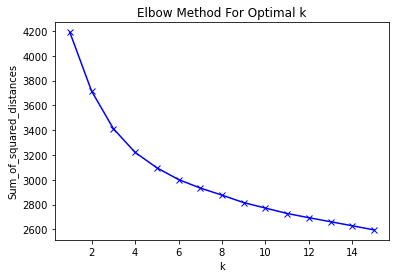

In [21]:
Sum_of_squared_distances = []
K = range(1,16)
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(cluster_trans)
    Sum_of_squared_distances.append(km.inertia_)
    
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

In [22]:
# --> Fit KMeans
kmeans = KMeans(n_clusters = 5, random_state = 2022)
kmeans.fit(cluster_trans)

KMeans(n_clusters=5, random_state=2022)

In [23]:
playstyle_cluster = kmeans.fit_predict(cluster_trans)
all_data['Cluster'] = playstyle_cluster + 1
all_data = all_data.reset_index(drop = True)
all_data['Cluster'].value_counts()

5    730
2    723
4    720
1    690
3    616
Name: Cluster, dtype: int64

### Check Multicolinearity

In [24]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif_data = all_data.dropna(axis=1).drop(['name','TeamID','conference'],axis=1)
vif_df = pd.DataFrame()
vif_df['Feature'] = vif_data.columns

# calculating VIF for each feature
vif_df["VIF"] = [variance_inflation_factor(vif_data.values, i) for i in range(len(vif_data.columns))]
  
vif_df.sort_values('VIF', ascending = False)

C:\Users\Robby\anaconda3\lib\site-packages\statsmodels\stats\outliers_influence.py:193: RuntimeWarning: divide by zero encountered in double_scalars
  vif = 1. / (1. - r_squared_i)


,Feature,VIF
90,three_point_field_goals_per_game,inf
61,field_goals_per_game,inf
91,two_point_field_goals_per_game,inf
89,three_point_field_goal_attempts_per_game,inf
93,total_rebounds_per_game,inf
84,opp_total_rebounds_per_game,inf
83,opp_two_point_field_goals_per_game,inf
82,opp_three_point_field_goals_per_game,inf
81,opp_two_point_field_goal_attempts_per_game,inf
80,opp_three_point_field_goal_attempts_per_game,inf


### Prep for Modeling

In [25]:
tournament_sub = tournament[tournament['Season'] >= 2012]
tourn_1 = tournament_sub.loc[:, ['Season','WTeamID','LTeamID']].reset_index(drop=True)
tourn_1.columns = ['Season','TeamID_A','TeamID_B']
tourn_1['Result'] = 1
tourn_2 = tournament_sub.loc[:, ['Season','LTeamID','WTeamID']]
tourn_2.columns = ['Season','TeamID_A','TeamID_B']
tourn_2['Result'] = 0

tournament_sub = pd.concat([tourn_1,tourn_2])

data_2022 = all_data[all_data["Season"] == 2022]
all_data = all_data[all_data["Season"] != 2022]

In [26]:
all_data = pd.get_dummies(all_data, columns = ['conference','Cluster'])
data_2022 = pd.get_dummies(data_2022, columns = ['conference','Cluster'])

In [27]:
model_data = pd.merge(tournament_sub, all_data, how = 'left', left_on = ['TeamID_A','Season'], right_on = ['TeamID','Season'])
model_data = pd.merge(model_data, all_data, how = 'left', left_on = ['TeamID_B','Season'], right_on = ['TeamID','Season'])
model_data = model_data.drop(['TeamID_x','TeamID_y'], axis = 1)

In [28]:
print(model_data.shape)
model_data = model_data.dropna(axis = 1)
print(model_data.shape)
print()
print(data_2022.shape)
data_2022 = data_2022.dropna(axis = 1)
print(data_2022.shape)

(1204, 350)
(1204, 276)

(353, 173)
(353, 169)


In [29]:
# --> Grab Target var
model_data.head(1)
x = model_data.drop(['Season','TeamID_A','name_x','name_y','TeamID_B','Result','minutes_played_per_game_x','minutes_played_per_game_y'], axis = 1)
y = model_data['Result']

# --> Test
x_2022 = data_2022.drop(['Season','TeamID','name'], axis = 1)
#y_2022 = data_2022['Result']

In [30]:
x.head()

,assist_percentage_x,block_percentage_x,effective_field_goal_percentage_x,field_goal_percentage_x,free_throw_attempt_rate_x,free_throw_percentage_x,free_throws_per_field_goal_attempt_x,offensive_rating_x,offensive_rebound_percentage_x,opp_assist_percentage_x,opp_block_percentage_x,opp_effective_field_goal_percentage_x,opp_field_goal_percentage_x,opp_free_throw_attempt_rate_x,opp_free_throw_percentage_x,opp_free_throws_per_field_goal_attempt_x,opp_offensive_rebound_percentage_x,opp_steal_percentage_x,opp_three_point_attempt_rate_x,opp_three_point_field_goal_percentage_x,opp_two_point_field_goal_percentage_x,opp_total_rebound_percentage_x,opp_true_shooting_percentage_x,opp_turnover_percentage_x,pace_x,simple_rating_system_x,steal_percentage_x,strength_of_schedule_x,three_point_attempt_rate_x,three_point_field_goal_percentage_x,two_point_field_goal_percentage_x,total_rebound_percentage_x,true_shooting_percentage_x,turnover_percentage_x,win_percentage_x,7OT_x,BBT_x,BIH_x,COL_x,DCI_x,DOK_x,DOL_x,DUN_x,EBP_x,KPK_x,KRA_x,MAS_x,MOR_x,PGH_x,POM_x,RT_x,RTP_x,SAG_x,SEL_x,SFX_x,WIL_x,WLK_x,WOB_x,assists_per_game_x,blocks_per_game_x,defensive_rebounds_per_game_x,field_goal_attempts_per_game_x,field_goals_per_game_x,free_throw_attempts_per_game_x,free_throws_per_game_x,home_wins_per_game_x,away_wins_per_game_x,conference_wins_per_game_x,offensive_rebounds_per_game_x,opp_assists_per_game_x,opp_blocks_per_game_x,opp_defensive_rebounds_per_game_x,opp_field_goal_attempts_per_game_x,opp_field_goals_per_game_x,opp_free_throw_attempts_per_game_x,opp_free_throws_per_game_x,opp_offensive_rebounds_per_game_x,opp_personal_fouls_per_game_x,opp_points_per_game_x,opp_steals_per_game_x,opp_three_point_field_goal_attempts_per_game_x,opp_two_point_field_goal_attempts_per_game_x,opp_three_point_field_goals_per_game_x,opp_two_point_field_goals_per_game_x,opp_total_rebounds_per_game_x,opp_turnovers_per_game_x,personal_fouls_per_game_x,points_per_game_x,steals_per_game_x,three_point_field_goal_attempts_per_game_x,three_point_field_goals_per_game_x,two_point_field_goals_per_game_x,two_point_field_goal_attempts_per_game_x,total_rebounds_per_game_x,turnovers_per_game_x,conference_aac_x,conference_acc_x,conference_america-east_x,conference_atlantic-10_x,conference_atlantic-sun_x,conference_big-12_x,conference_big-east_x,conference_big-sky_x,conference_big-south_x,conference_big-ten_x,conference_big-west_x,conference_colonial_x,conference_cusa_x,conference_great-west_x,conference_horizon_x,conference_independent_x,conference_ivy_x,conference_maac_x,conference_mac_x,conference_meac_x,conference_mvc_x,conference_mwc_x,conference_northeast_x,conference_ovc_x,conference_pac-12_x,conference_patriot_x,conference_sec_x,conference_southern_x,conference_southland_x,conference_summit_x,conference_sun-belt_x,conference_swac_x,conference_wac_x,conference_wcc_x,Cluster_1_x,Cluster_2_x,Cluster_3_x,Cluster_4_x,Cluster_5_x,assist_percentage_y,block_percentage_y,effective_field_goal_percentage_y,field_goal_percentage_y,free_throw_attempt_rate_y,free_throw_percentage_y,free_throws_per_field_goal_attempt_y,offensive_rating_y,offensive_rebound_percentage_y,opp_assist_percentage_y,opp_block_percentage_y,opp_effective_field_goal_percentage_y,opp_field_goal_percentage_y,opp_free_throw_attempt_rate_y,opp_free_throw_percentage_y,opp_free_throws_per_field_goal_attempt_y,opp_offensive_rebound_percentage_y,opp_steal_percentage_y,opp_three_point_attempt_rate_y,opp_three_point_field_goal_percentage_y,opp_two_point_field_goal_percentage_y,opp_total_rebound_percentage_y,opp_true_shooting_percentage_y,opp_turnover_percentage_y,pace_y,simple_rating_system_y,steal_percentage_y,strength_of_schedule_y,three_point_attempt_rate_y,three_point_field_goal_percentage_y,two_point_field_goal_percentage_y,total_rebound_percentage_y,true_shooting_percentage_y,turnover_percentage_y,win_percentage_y,7OT_y,BBT_y,BIH_y,COL_y,DCI_y,DOK_y,DOL_y,DUN_y,EBP_y,KPK_y,KRA_y,MAS_y,MOR_y,PGH_y,POM_y,RT_y,RTP_y,SAG_y,SEL_y,SFX

In [31]:
# --> Scale Data (fix convergence issue)
from sklearn.preprocessing import StandardScaler
ss = StandardScaler()
ss.fit(x)
x_trans = ss.fit_transform(x)
x = pd.DataFrame(x_trans, columns = x.columns)

In [32]:
# --> Train Valid Split
train_x, valid_x, train_y, valid_y = train_test_split(x,y, test_size = 0.33, random_state = 2022)

### Ready2Model

#### LASSO Classifiers to get some var selection

#### InterpretML

In [33]:
from interpret import set_visualize_provider
from interpret.provider import InlineProvider
set_visualize_provider(InlineProvider())
from interpret.glassbox import ExplainableBoostingClassifier
from interpret import show

In [34]:
ebm = ExplainableBoostingClassifier(random_state=2022)
ebm.fit(train_x, train_y)

ebm_global = ebm.explain_global()
show(ebm_global)

In [35]:
print(ebm.score(train_x,train_y))
print(ebm.score(valid_x,valid_y))

0.9454094292803971
0.7261306532663316


In [36]:
from sklearn.metrics import log_loss
params = {
    # Parameters that we are going to tune.
    'max_bins': 256,
    'max_interaction_bins': 32,
    'binning': 'quantile',
    'interactions': 10,
    'outer_bags': 8,
    'inner_bags': 0,
    'learning_rate': 0.01,
    'min_samples_leaf': 2,
    'max_leaves': 3
}

In [ ]:
import xgboost as xgb

dtrain = xgb.DMatrix(train_x,label=train_y)
dtest = xgb.DMatrix(valid_x,label=valid_y)

params = {
    # Parameters that we are going to tune.
    'max_depth':6,
    'min_child_weight': 1,
    'eta':.3,
    'subsample': 1,
    'colsample_bytree': 1,
    # Other parameters
    'objective':'binary:logistic',
}

params['eval_metric'] ='logloss'
num_boost_rounds = 250

model = xgb.train(
    params,
    dtrain,
    num_boost_round=num_boost_rounds,
    evals=[(dtest,'Test')],
    early_stopping_rounds=10
    )

print("Best logloss: {:.2f} with {} rounds".format(
                 model.best_score,
                 model.best_iteration+1))

In [ ]:
cv_results = xgb.cv(
    params,
    dtrain,
    num_boost_round=num_boost_rounds,
    seed=1234,
    nfold=5,
    metrics={'logloss'},
    early_stopping_rounds=10
)
cv_results
cv_results['test-logloss-mean'].min()

In [ ]:
#%% Grid for max depth and child weight
gridsearch_params = [
    (max_depth, min_child_weight)
    for max_depth in range(2,5,1)
    for min_child_weight in range(2,25,2)]
        
# Define initial best params and AUC
min_ll = float(9999)
best_params = None
for max_depth, min_child_weight in gridsearch_params:
    print("CV with max_depth={}, min_child_weight={}".format(
                             max_depth,
                             min_child_weight))
    # Update our parameters
    params['max_depth'] = max_depth
    params['min_child_weight'] = min_child_weight
    # Run CV
    cv_results = xgb.cv(
        params,
        dtrain,
        num_boost_round=num_boost_rounds,
        seed=2022,
        nfold=5,
        metrics={'logloss'},
        early_stopping_rounds=10
    )
    # Update best Log Loss
    mean_ll = cv_results['test-logloss-mean'].min()
    boost_rounds = cv_results['test-logloss-mean'].argmin()
    print("\tLog Loss {} for {} rounds".format(mean_ll, boost_rounds))
    if mean_ll < min_ll:
        min_ll = mean_ll
        best_params = (max_depth,min_child_weight)
print("Best params: {}, {}, Log Loss: {}".format(best_params[0], best_params[1], min_ll))


In [ ]:
params['max_depth'] = 3
params['min_child_weight'] = 8

In [ ]:
#%% Grid for max depth and child weight
gridsearch_params = [
    (subsample, colsample)
    for subsample in [i/10. for i in range(1,11)]
    for colsample in [i/10. for i in range(1,11)]
]        
# Define initial best params and AUC
min_ll = float(9999)
best_params = None
for subsample, colsample in gridsearch_params:
    print("CV with subsample={}, colsample={}".format(
                             subsample,
                             colsample))
    # Update our parameters
    params['subsample'] = subsample
    params['colsample_bytree'] = colsample
    # Run CV
    cv_results = xgb.cv(
        params,
        dtrain,
        num_boost_round=num_boost_rounds,
        seed=2022,
        nfold=5,
        metrics={'logloss'},
        early_stopping_rounds=10
    )
    # Update best Log Loss
    mean_ll = cv_results['test-logloss-mean'].min()
    boost_rounds = cv_results['test-logloss-mean'].argmin()
    print("\tLog Loss {} for {} rounds".format(mean_ll, boost_rounds))
    if mean_ll < min_ll:
        min_ll = mean_ll
        best_params = (subsample,colsample)
print("Best params: {}, {}, Log Loss: {}".format(best_params[0], best_params[1], min_ll))

In [ ]:
params['subsample'] = 1
params['colsample_bytree'] = 1

In [ ]:
# Define initial best params and AUC
min_ll = float(9999)
best_params = None
for eta in range(20,31,1):
    print("CV with eta={}".format(eta/100))
    # We update our parameters
    params['eta'] = eta/100
    # Run and time CV
    cv_results = xgb.cv(
            params,
            dtrain,
            num_boost_round=num_boost_rounds,
            seed=2022,
            nfold=5,
            metrics=['logloss'],
            early_stopping_rounds=10
          )
    # Update best score
    mean_ll = cv_results['test-logloss-mean'].min()
    boost_rounds = cv_results['test-logloss-mean'].argmin()
    print("\tLog Loss {} for {} rounds\n".format(mean_ll, boost_rounds))
    if mean_ll < min_ll:
        min_ll = mean_ll
        best_params = eta/100
print("Best params: {}, Log Loss: {}".format(best_params, min_ll))


In [ ]:
params['eta'] = 0.3

In [ ]:
dtrain = xgb.DMatrix(train_x,label=train_y)
num_boost_rounds = 999
model_xgb = xgb.train(
    params,
    dtrain,
    num_boost_round=num_boost_rounds,
    evals=[(dtest, "Test")],
    early_stopping_rounds=10)

print("Best Log Loss: {:.2f} in {} rounds".format(model_xgb.best_score, model_xgb.best_iteration+1))

In [ ]:
ebm = ExplainableBoostingClassifier(random_state=2022)
ebm.fit(train_x, train_y)
pp1 = ebm.predict_proba(train_x)
pp2 = ebm.predict_proba(valid_x)

print(log_loss(train_y,pp1))
print(log_loss(valid_y,pp2))

In [ ]:
from sklearn.metrics import log_loss
params = {
    # Parameters that we are going to tune.
    'max_bins': 256,
    'max_interaction_bins': 32,
    'binning': 'quantile',
    'interactions': 10,
    'outer_bags': 8,
    'inner_bags': 0,
    'learning_rate': 0.01,
    'min_samples_leaf': 2,
    'max_leaves': 3,
    # Params we leave stable
    'random_state' : 2022
}

In [ ]:
ebm = ExplainableBoostingClassifier(**params)
ebm.fit(train_x, train_y)
pp1 = ebm.predict_proba(train_x)
pp2 = ebm.predict_proba(valid_x)

print(log_loss(train_y,pp1))
print(log_loss(valid_y,pp2))

In [41]:
def hp_tune(param, range_min, range_max, range_int):
    """
    Hyper parameter tuning
    
    Inputs:
    param : parameter to tune
    range_min = min value
    range_min = max value
    range_int = interval
    div = divsor used for learning_rates
    """
    min_ll = float(9999)
    best_params = None
    for i in range(range_min, range_max, range_int):
        print("CV with " + param + " = {}".format(i))
        # We update our parameters
        params[param] = i
        # Run and time CV
        ebm = ExplainableBoostingClassifier(**params)
        ebm.fit(train_x, train_y)
        pp2 = ebm.predict_proba(valid_x)

        # Update best score
        mean_ll = log_loss(valid_y,pp2)
        print("\tLog Loss {}".format(mean_ll))
        if mean_ll < min_ll:
            min_ll = mean_ll
            best_params = i
    print("Best params: {}, Log Loss: {}".format(best_params, min_ll))
    
    import winsound
    duration = 1000  # milliseconds
    freq = 440  # Hz
    
    params[param] = best_params
    
    return winsound.Beep(freq, duration), params

In [42]:
hp_tune('max_bins', 220, 240, 2)

CV with max_bins = 220
	Log Loss 0.5057414942825483
CV with max_bins = 222
	Log Loss 0.5055690454297649
CV with max_bins = 224
	Log Loss 0.5059030520708617
CV with max_bins = 226
	Log Loss 0.5058590928812482
CV with max_bins = 228
	Log Loss 0.5056797519071293
CV with max_bins = 230
	Log Loss 0.5057779540375816
CV with max_bins = 232
	Log Loss 0.5075846701812078
CV with max_bins = 234
	Log Loss 0.5056719952568067
CV with max_bins = 236
	Log Loss 0.5101442601067575
CV with max_bins = 238
	Log Loss 0.5054935819305806
Best params: 238, Log Loss: 0.5054935819305806


(None,
 {'max_bins': 238,
  'max_interaction_bins': 32,
  'binning': 'quantile',
  'interactions': 10,
  'outer_bags': 8,
  'inner_bags': 0,
  'learning_rate': 0.01,
  'min_samples_leaf': 2,
  'max_leaves': 3})

In [43]:
hp_tune('max_interaction_bins', 10, 51, 5)

CV with max_interaction_bins = 10
	Log Loss 0.5164957179616076
CV with max_interaction_bins = 15
	Log Loss 0.517974509694919
CV with max_interaction_bins = 20
	Log Loss 0.5127635680811534
CV with max_interaction_bins = 25
	Log Loss 0.5217757147456538
CV with max_interaction_bins = 30
	Log Loss 0.5112635651752155
CV with max_interaction_bins = 35
	Log Loss 0.5113266482707413
CV with max_interaction_bins = 40
	Log Loss 0.5058268094181229
CV with max_interaction_bins = 45
	Log Loss 0.5113587829014838
CV with max_interaction_bins = 50
	Log Loss 0.509903961790248
Best params: 40, Log Loss: 0.5058268094181229


(None,
 {'max_bins': 238,
  'max_interaction_bins': 40,
  'binning': 'quantile',
  'interactions': 10,
  'outer_bags': 8,
  'inner_bags': 0,
  'learning_rate': 0.01,
  'min_samples_leaf': 2,
  'max_leaves': 3})

In [44]:
hp_tune('interactions', 24, 33, 3)

CV with interactions = 24
	Log Loss 0.5177828370568683
CV with interactions = 27
	Log Loss 0.5204963074517603
CV with interactions = 30
	Log Loss 0.5206559113467829
Best params: 24, Log Loss: 0.5177828370568683


(None,
 {'max_bins': 238,
  'max_interaction_bins': 40,
  'binning': 'quantile',
  'interactions': 24,
  'outer_bags': 8,
  'inner_bags': 0,
  'learning_rate': 0.01,
  'min_samples_leaf': 2,
  'max_leaves': 3})

In [45]:
hp_tune('outer_bags', 6, 21, 2)

CV with outer_bags = 6
	Log Loss 0.5112989360522383
CV with outer_bags = 8
	Log Loss 0.5177828370568683
CV with outer_bags = 10
	Log Loss 0.5149513121118089
CV with outer_bags = 12
	Log Loss 0.5152199100550847
CV with outer_bags = 14
	Log Loss 0.5137904928170679
CV with outer_bags = 16
	Log Loss 0.5115985037028005
CV with outer_bags = 18
	Log Loss 0.5140325824963726
CV with outer_bags = 20
	Log Loss 0.5156395997481494
Best params: 6, Log Loss: 0.5112989360522383


(None,
 {'max_bins': 238,
  'max_interaction_bins': 40,
  'binning': 'quantile',
  'interactions': 24,
  'outer_bags': 6,
  'inner_bags': 0,
  'learning_rate': 0.01,
  'min_samples_leaf': 2,
  'max_leaves': 3})

In [46]:
hp_tune('inner_bags', 0, 11, 2)

CV with inner_bags = 0
	Log Loss 0.5112989360522383
CV with inner_bags = 2
	Log Loss 0.5109187182987079
CV with inner_bags = 4
	Log Loss 0.5030238227524033
CV with inner_bags = 6
	Log Loss 0.5057157731210544
CV with inner_bags = 8
	Log Loss 0.49727153658766876
CV with inner_bags = 10
	Log Loss 0.49701714778441414
Best params: 10, Log Loss: 0.49701714778441414


(None,
 {'max_bins': 238,
  'max_interaction_bins': 40,
  'binning': 'quantile',
  'interactions': 24,
  'outer_bags': 6,
  'inner_bags': 10,
  'learning_rate': 0.01,
  'min_samples_leaf': 2,
  'max_leaves': 3})

In [47]:
hp_tune('min_samples_leaf', 18, 20, 1)

CV with min_samples_leaf = 18
	Log Loss 0.4983769044177019
CV with min_samples_leaf = 19
	Log Loss 0.5002424759337202
Best params: 18, Log Loss: 0.4983769044177019


(None,
 {'max_bins': 238,
  'max_interaction_bins': 40,
  'binning': 'quantile',
  'interactions': 24,
  'outer_bags': 6,
  'inner_bags': 10,
  'learning_rate': 0.01,
  'min_samples_leaf': 18,
  'max_leaves': 3})

In [48]:
hp_tune('max_leaves', 2, 6, 1)

CV with max_leaves = 2
	Log Loss 0.4952399994559835
CV with max_leaves = 3
	Log Loss 0.4983769044177019
CV with max_leaves = 4
	Log Loss 0.5106264930345756
CV with max_leaves = 5
	Log Loss 0.5128461386541553
Best params: 2, Log Loss: 0.4952399994559835


(None,
 {'max_bins': 238,
  'max_interaction_bins': 40,
  'binning': 'quantile',
  'interactions': 24,
  'outer_bags': 6,
  'inner_bags': 10,
  'learning_rate': 0.01,
  'min_samples_leaf': 18,
  'max_leaves': 2})

In [49]:
param = 'learning_rate'
min_ll = float(9999)
best_params = None
for i in [0.000001, 0.00001, 0.0001, 0.001, 0.005, 0.01, 0.05, 0.1]:
    print("CV with " + param + " = {}".format(i))
    # We update our parameters
    params[param] = i
    # Run and time CV
    ebm = ExplainableBoostingClassifier(**params)
    ebm.fit(train_x, train_y)
    pp2 = ebm.predict_proba(valid_x)

    # Update best score
    mean_ll = log_loss(valid_y,pp2)
    print("\tLog Loss {}".format(mean_ll))
    if mean_ll < min_ll:
        min_ll = mean_ll
        best_params = i
print("Best params: {}, Log Loss: {}".format(best_params, min_ll))

import winsound
duration = 1000  # milliseconds
freq = 440  # Hz

params[param] = best_params

winsound.Beep(freq, duration)

CV with learning_rate = 1e-06
	Log Loss 0.6464823090720296
CV with learning_rate = 1e-05
	Log Loss 0.5434422240171415
CV with learning_rate = 0.0001
	Log Loss 0.5052366733414372
CV with learning_rate = 0.001
	Log Loss 0.5024325336353676
CV with learning_rate = 0.005
	Log Loss 0.495397113326797
CV with learning_rate = 0.01
	Log Loss 0.4952399994559835
CV with learning_rate = 0.05
	Log Loss 0.49517309732928494
CV with learning_rate = 0.1
	Log Loss 0.4964481411499449
Best params: 0.05, Log Loss: 0.49517309732928494


In [50]:
ebm = ExplainableBoostingClassifier(**params)
ebm.fit(x,y)
pp3 = ebm.predict_proba(x)
print(log_loss(y,pp3))

0.21642590368434367


### Import 2022 Tourney Matchups and Predict

In [51]:
submission = pd.read_csv(INPUT_FOLDER + "MSampleSubmissionStage2.csv")
submission.head()

,ID,Pred
0,2022_1103_1104,0.5
1,2022_1103_1112,0.5
2,2022_1103_1116,0.5
3,2022_1103_1120,0.5
4,2022_1103_1124,0.5


In [52]:
submission["Season"] = submission["ID"].str.split("_", expand = True)[0]
submission["TeamID_A"] = submission["ID"].str.split("_", expand = True)[1]
submission["TeamID_B"] = submission["ID"].str.split("_", expand = True)[2]

In [53]:
submission2 = submission.drop(['ID','Pred'], axis = 1)

In [54]:
submission2[["TeamID_A","TeamID_B"]] = submission2[["TeamID_A","TeamID_B"]].astype('int')

In [55]:
s1_2022 = pd.merge(submission2, data_2022, how = 'left', left_on = 'TeamID_A', right_on = 'TeamID')
subs = pd.merge(s1_2022, data_2022, how = 'left', left_on = 'TeamID_B', right_on = 'TeamID')
subs.head()

,Season_x,TeamID_A,TeamID_B,name_x,TeamID_x,assist_percentage_x,block_percentage_x,effective_field_goal_percentage_x,field_goal_percentage_x,free_throw_attempt_rate_x,free_throw_percentage_x,free_throws_per_field_goal_attempt_x,offensive_rating_x,offensive_rebound_percentage_x,opp_assist_percentage_x,opp_block_percentage_x,opp_effective_field_goal_percentage_x,opp_field_goal_percentage_x,opp_free_throw_attempt_rate_x,opp_free_throw_percentage_x,opp_free_throws_per_field_goal_attempt_x,opp_offensive_rebound_percentage_x,opp_steal_percentage_x,opp_three_point_attempt_rate_x,opp_three_point_field_goal_percentage_x,opp_two_point_field_goal_percentage_x,opp_total_rebound_percentage_x,opp_true_shooting_percentage_x,opp_turnover_percentage_x,pace_x,simple_rating_system_x,steal_percentage_x,strength_of_schedule_x,three_point_attempt_rate_x,three_point_field_goal_percentage_x,two_point_field_goal_percentage_x,total_rebound_percentage_x,true_shooting_percentage_x,turnover_percentage_x,win_percentage_x,Season_y,7OT_x,ARG_x,ATP_x,BAR_x,BBT_x,BIH_x,BNZ_x,BWE_x,CBR_x,COL_x,CWL_x,DAV_x,DCI_x,DII_x,DOK_x,DOL_x,DUN_x,EBP_x,EMK_x,ESR_x,FAS_x,HAS_x,INC_x,JJK_x,JNG_x,KCX_x,KPK_x,KRA_x,LAB_x,LAW_x,LOG_x,MAS_x,MOR_x,NET_x,NOL_x,OMN_x,PGH_x,PIR_x,POM_x,RT_x,RTH_x,RTP_x,SAG_x,SEL_x,SFX_x,SMS_x,SPR_x,STH_x,TPR_x,TRK_x,TRP_x,WIL_x,WLK_x,WMV_x,WOB_x,WOL_x,assists_per_game_x,blocks_per_game_x,defensive_rebounds_per_game_x,field_goal_attempts_per_game_x,field_goals_per_game_x,free_throw_attempts_per_game_x,free_throws_per_game_x,home_wins_per_game_x,away_wins_per_game_x,conference_wins_per_game_x,minutes_played_per_game_x,offensive_rebounds_per_game_x,opp_assists_per_game_x,opp_blocks_per_game_x,opp_defensive_rebounds_per_game_x,opp_field_goal_attempts_per_game_x,opp_field_goals_per_game_x,opp_free_throw_attempts_per_game_x,opp_free_throws_per_game_x,opp_offensive_rebounds_per_game_x,opp_personal_fouls_per_game_x,opp_points_per_game_x,opp_steals_per_game_x,opp_three_point_field_goal_attempts_per_game_x,opp_two_point_field_goal_attempts_per_game_x,opp_three_point_field_goals_per_game_x,opp_two_point_field_goals_per_game_x,opp_total_rebounds_per_game_x,opp_turnovers_per_game_x,personal_fouls_per_game_x,points_per_game_x,steals_per_game_x,three_point_field_goal_attempts_per_game_x,three_point_field_goals_per_game_x,two_point_field_goals_per_game_x,two_point_field_goal_attempts_per_game_x,total_rebounds_per_game_x,turnovers_per_game_x,conference_aac_x,conference_acc_x,conference_america-east_x,conference_atlantic-10_x,conference_atlantic-sun_x,conference_big-12_x,conference_big-east_x,conference_big-sky_x,conference_big-south_x,conference_big-ten_x,conference_big-west_x,conference_colonial_x,conference_cusa_x,conference_horizon_x,conference_ivy_x,conference_maac_x,conference_mac_x,conference_meac_x,conference_mvc_x,conference_mwc_x,conference_northeast_x,conference_ovc_x,conference_pac-12_x,conference_patriot_x,conference_sec_x,conference_southern_x,conference_southland_x,conference_summit_x,conference_sun-belt_x,conference_swac_x,conference_wac_x,conference_wcc_x,Cluster_1_x,Cluster_2_x,Cluster_3_x,Cluster_4_x,Cluster_5_x,name_y,TeamID_y,assist_percentage_y,block_percentage_y,effective_field_goal_percentage_y,field_goal_percentage_y,free_throw_attempt_rate_y,free_throw_percentage_y,free_throws_per_field_goal_attempt_y,offensive_rating_y,offensive_rebound_percentage_y,opp_assist_percentage_y,opp_block_percentage_y,opp_effective_field_goal_percentage_y,opp_field_goal_percentage_y,opp_free_throw_attempt_rate_y,opp_free_throw_percentage_y,opp_free_throws_per_field_goal_attempt_y,opp_offensive_rebound_percentage_y,opp_steal_percentage_y,opp_three_point_attempt_rate_y,opp_three_point_field_goal_percentage_y,opp_two_point_field_goal_percentage_y,opp_total_rebound_percentage_y,opp_true_shooting_percentage_y,opp_turnover_percentage_y,pace_y,simple_rating_system_y,steal_percentage_y,strength_of_schedule_y,three_point_attempt_rate_y,three_point_field_goal_percentage_y,

In [56]:
sub_full = subs.drop(['Season_x','Season_y','TeamID_A','TeamID_x','TeamID_y','name_x','name_y','TeamID_B','minutes_played_per_game_x','minutes_played_per_game_y'], axis = 1)
sub_full2 = subs.drop(['Season_x','Season_y','TeamID_x','name_x','name_y','TeamID_y','minutes_played_per_game_x','minutes_played_per_game_y'], axis = 1)

sub_full.head()

,assist_percentage_x,block_percentage_x,effective_field_goal_percentage_x,field_goal_percentage_x,free_throw_attempt_rate_x,free_throw_percentage_x,free_throws_per_field_goal_attempt_x,offensive_rating_x,offensive_rebound_percentage_x,opp_assist_percentage_x,opp_block_percentage_x,opp_effective_field_goal_percentage_x,opp_field_goal_percentage_x,opp_free_throw_attempt_rate_x,opp_free_throw_percentage_x,opp_free_throws_per_field_goal_attempt_x,opp_offensive_rebound_percentage_x,opp_steal_percentage_x,opp_three_point_attempt_rate_x,opp_three_point_field_goal_percentage_x,opp_two_point_field_goal_percentage_x,opp_total_rebound_percentage_x,opp_true_shooting_percentage_x,opp_turnover_percentage_x,pace_x,simple_rating_system_x,steal_percentage_x,strength_of_schedule_x,three_point_attempt_rate_x,three_point_field_goal_percentage_x,two_point_field_goal_percentage_x,total_rebound_percentage_x,true_shooting_percentage_x,turnover_percentage_x,win_percentage_x,7OT_x,ARG_x,ATP_x,BAR_x,BBT_x,BIH_x,BNZ_x,BWE_x,CBR_x,COL_x,CWL_x,DAV_x,DCI_x,DII_x,DOK_x,DOL_x,DUN_x,EBP_x,EMK_x,ESR_x,FAS_x,HAS_x,INC_x,JJK_x,JNG_x,KCX_x,KPK_x,KRA_x,LAB_x,LAW_x,LOG_x,MAS_x,MOR_x,NET_x,NOL_x,OMN_x,PGH_x,PIR_x,POM_x,RT_x,RTH_x,RTP_x,SAG_x,SEL_x,SFX_x,SMS_x,SPR_x,STH_x,TPR_x,TRK_x,TRP_x,WIL_x,WLK_x,WMV_x,WOB_x,WOL_x,assists_per_game_x,blocks_per_game_x,defensive_rebounds_per_game_x,field_goal_attempts_per_game_x,field_goals_per_game_x,free_throw_attempts_per_game_x,free_throws_per_game_x,home_wins_per_game_x,away_wins_per_game_x,conference_wins_per_game_x,offensive_rebounds_per_game_x,opp_assists_per_game_x,opp_blocks_per_game_x,opp_defensive_rebounds_per_game_x,opp_field_goal_attempts_per_game_x,opp_field_goals_per_game_x,opp_free_throw_attempts_per_game_x,opp_free_throws_per_game_x,opp_offensive_rebounds_per_game_x,opp_personal_fouls_per_game_x,opp_points_per_game_x,opp_steals_per_game_x,opp_three_point_field_goal_attempts_per_game_x,opp_two_point_field_goal_attempts_per_game_x,opp_three_point_field_goals_per_game_x,opp_two_point_field_goals_per_game_x,opp_total_rebounds_per_game_x,opp_turnovers_per_game_x,personal_fouls_per_game_x,points_per_game_x,steals_per_game_x,three_point_field_goal_attempts_per_game_x,three_point_field_goals_per_game_x,two_point_field_goals_per_game_x,two_point_field_goal_attempts_per_game_x,total_rebounds_per_game_x,turnovers_per_game_x,conference_aac_x,conference_acc_x,conference_america-east_x,conference_atlantic-10_x,conference_atlantic-sun_x,conference_big-12_x,conference_big-east_x,conference_big-sky_x,conference_big-south_x,conference_big-ten_x,conference_big-west_x,conference_colonial_x,conference_cusa_x,conference_horizon_x,conference_ivy_x,conference_maac_x,conference_mac_x,conference_meac_x,conference_mvc_x,conference_mwc_x,conference_northeast_x,conference_ovc_x,conference_pac-12_x,conference_patriot_x,conference_sec_x,conference_southern_x,conference_southland_x,conference_summit_x,conference_sun-belt_x,conference_swac_x,conference_wac_x,conference_wcc_x,Cluster_1_x,Cluster_2_x,Cluster_3_x,Cluster_4_x,Cluster_5_x,assist_percentage_y,block_percentage_y,effective_field_goal_percentage_y,field_goal_percentage_y,free_throw_attempt_rate_y,free_throw_percentage_y,free_throws_per_field_goal_attempt_y,offensive_rating_y,offensive_rebound_percentage_y,opp_assist_percentage_y,opp_block_percentage_y,opp_effective_field_goal_percentage_y,opp_field_goal_percentage_y,opp_free_throw_attempt_rate_y,opp_free_throw_percentage_y,opp_free_throws_per_field_goal_attempt_y,opp_offensive_rebound_percentage_y,opp_steal_percentage_y,opp_three_point_attempt_rate_y,opp_three_point_field_goal_percentage_y,opp_two_point_field_goal_percentage_y,opp_total_rebound_percentage_y,opp_true_shooting_percentage_y,opp_turnover_percentage_y,pace_y,simple_rating_system_y,steal_percentage_y,strength_of_schedule_y,three_point_attempt_rate_y,three_point_field_goal_percentage_y,two_point_field_goal_percentage_y,total_rebound_percentage_y,true_shooting_percentage_y,turnov

In [57]:
x_trans = ss.fit_transform(sub_full)
sub_full = pd.DataFrame(x_trans, columns = sub_full.columns)
sub_full[['conference_independent_x', 'conference_independent_y', 'conference_great-west_x', 'conference_great-west_y']] = 0
sub_full = sub_full[x.columns]
sub = {'ID': submission["ID"]}
preds = ebm.predict_proba(sub_full)
sub['Pred'] = [i[1] for i in preds]

In [58]:
sub_full2[sub_full2['TeamID_A'] == 1124]

,TeamID_A,TeamID_B,assist_percentage_x,block_percentage_x,effective_field_goal_percentage_x,field_goal_percentage_x,free_throw_attempt_rate_x,free_throw_percentage_x,free_throws_per_field_goal_attempt_x,offensive_rating_x,offensive_rebound_percentage_x,opp_assist_percentage_x,opp_block_percentage_x,opp_effective_field_goal_percentage_x,opp_field_goal_percentage_x,opp_free_throw_attempt_rate_x,opp_free_throw_percentage_x,opp_free_throws_per_field_goal_attempt_x,opp_offensive_rebound_percentage_x,opp_steal_percentage_x,opp_three_point_attempt_rate_x,opp_three_point_field_goal_percentage_x,opp_two_point_field_goal_percentage_x,opp_total_rebound_percentage_x,opp_true_shooting_percentage_x,opp_turnover_percentage_x,pace_x,simple_rating_system_x,steal_percentage_x,strength_of_schedule_x,three_point_attempt_rate_x,three_point_field_goal_percentage_x,two_point_field_goal_percentage_x,total_rebound_percentage_x,true_shooting_percentage_x,turnover_percentage_x,win_percentage_x,7OT_x,ARG_x,ATP_x,BAR_x,BBT_x,BIH_x,BNZ_x,BWE_x,CBR_x,COL_x,CWL_x,DAV_x,DCI_x,DII_x,DOK_x,DOL_x,DUN_x,EBP_x,EMK_x,ESR_x,FAS_x,HAS_x,INC_x,JJK_x,JNG_x,KCX_x,KPK_x,KRA_x,LAB_x,LAW_x,LOG_x,MAS_x,MOR_x,NET_x,NOL_x,OMN_x,PGH_x,PIR_x,POM_x,RT_x,RTH_x,RTP_x,SAG_x,SEL_x,SFX_x,SMS_x,SPR_x,STH_x,TPR_x,TRK_x,TRP_x,WIL_x,WLK_x,WMV_x,WOB_x,WOL_x,assists_per_game_x,blocks_per_game_x,defensive_rebounds_per_game_x,field_goal_attempts_per_game_x,field_goals_per_game_x,free_throw_attempts_per_game_x,free_throws_per_game_x,home_wins_per_game_x,away_wins_per_game_x,conference_wins_per_game_x,offensive_rebounds_per_game_x,opp_assists_per_game_x,opp_blocks_per_game_x,opp_defensive_rebounds_per_game_x,opp_field_goal_attempts_per_game_x,opp_field_goals_per_game_x,opp_free_throw_attempts_per_game_x,opp_free_throws_per_game_x,opp_offensive_rebounds_per_game_x,opp_personal_fouls_per_game_x,opp_points_per_game_x,opp_steals_per_game_x,opp_three_point_field_goal_attempts_per_game_x,opp_two_point_field_goal_attempts_per_game_x,opp_three_point_field_goals_per_game_x,opp_two_point_field_goals_per_game_x,opp_total_rebounds_per_game_x,opp_turnovers_per_game_x,personal_fouls_per_game_x,points_per_game_x,steals_per_game_x,three_point_field_goal_attempts_per_game_x,three_point_field_goals_per_game_x,two_point_field_goals_per_game_x,two_point_field_goal_attempts_per_game_x,total_rebounds_per_game_x,turnovers_per_game_x,conference_aac_x,conference_acc_x,conference_america-east_x,conference_atlantic-10_x,conference_atlantic-sun_x,conference_big-12_x,conference_big-east_x,conference_big-sky_x,conference_big-south_x,conference_big-ten_x,conference_big-west_x,conference_colonial_x,conference_cusa_x,conference_horizon_x,conference_ivy_x,conference_maac_x,conference_mac_x,conference_meac_x,conference_mvc_x,conference_mwc_x,conference_northeast_x,conference_ovc_x,conference_pac-12_x,conference_patriot_x,conference_sec_x,conference_southern_x,conference_southland_x,conference_summit_x,conference_sun-belt_x,conference_swac_x,conference_wac_x,conference_wcc_x,Cluster_1_x,Cluster_2_x,Cluster_3_x,Cluster_4_x,Cluster_5_x,assist_percentage_y,block_percentage_y,effective_field_goal_percentage_y,field_goal_percentage_y,free_throw_attempt_rate_y,free_throw_percentage_y,free_throws_per_field_goal_attempt_y,offensive_rating_y,offensive_rebound_percentage_y,opp_assist_percentage_y,opp_block_percentage_y,opp_effective_field_goal_percentage_y,opp_field_goal_percentage_y,opp_free_throw_attempt_rate_y,opp_free_throw_percentage_y,opp_free_throws_per_field_goal_attempt_y,opp_offensive_rebound_percentage_y,opp_steal_percentage_y,opp_three_point_attempt_rate_y,opp_three_point_field_goal_percentage_y,opp_two_point_field_goal_percentage_y,opp_total_rebound_percentage_y,opp_true_shooting_percentage_y,opp_turnover_percentage_y,pace_y,simple_rating_system_y,steal_percentage_y,strength_of_schedule_y,three_point_attempt_rate_y,three_point_field_goal_percentage_y,two_point_field_goal_percentage_y,total_rebound_percentage_y,true_shooting_p

In [60]:
sub_full.to_csv("MMPreds_EBM_2022.csv")

PermissionError: [Errno 13] Permission denied: 'MMPreds_EBM_2022.csv'

In [61]:
ebm_glob = ebm.explain_global()
show(ebm_glob)
#ebm_loc = ebm.explain_local()

In [62]:
sub_full.iloc[358:359,]

,assist_percentage_x,block_percentage_x,effective_field_goal_percentage_x,field_goal_percentage_x,free_throw_attempt_rate_x,free_throw_percentage_x,free_throws_per_field_goal_attempt_x,offensive_rating_x,offensive_rebound_percentage_x,opp_assist_percentage_x,opp_block_percentage_x,opp_effective_field_goal_percentage_x,opp_field_goal_percentage_x,opp_free_throw_attempt_rate_x,opp_free_throw_percentage_x,opp_free_throws_per_field_goal_attempt_x,opp_offensive_rebound_percentage_x,opp_steal_percentage_x,opp_three_point_attempt_rate_x,opp_three_point_field_goal_percentage_x,opp_two_point_field_goal_percentage_x,opp_total_rebound_percentage_x,opp_true_shooting_percentage_x,opp_turnover_percentage_x,pace_x,simple_rating_system_x,steal_percentage_x,strength_of_schedule_x,three_point_attempt_rate_x,three_point_field_goal_percentage_x,two_point_field_goal_percentage_x,total_rebound_percentage_x,true_shooting_percentage_x,turnover_percentage_x,win_percentage_x,7OT_x,BBT_x,BIH_x,COL_x,DCI_x,DOK_x,DOL_x,DUN_x,EBP_x,KPK_x,KRA_x,MAS_x,MOR_x,PGH_x,POM_x,RT_x,RTP_x,SAG_x,SEL_x,SFX_x,WIL_x,WLK_x,WOB_x,assists_per_game_x,blocks_per_game_x,defensive_rebounds_per_game_x,field_goal_attempts_per_game_x,field_goals_per_game_x,free_throw_attempts_per_game_x,free_throws_per_game_x,home_wins_per_game_x,away_wins_per_game_x,conference_wins_per_game_x,offensive_rebounds_per_game_x,opp_assists_per_game_x,opp_blocks_per_game_x,opp_defensive_rebounds_per_game_x,opp_field_goal_attempts_per_game_x,opp_field_goals_per_game_x,opp_free_throw_attempts_per_game_x,opp_free_throws_per_game_x,opp_offensive_rebounds_per_game_x,opp_personal_fouls_per_game_x,opp_points_per_game_x,opp_steals_per_game_x,opp_three_point_field_goal_attempts_per_game_x,opp_two_point_field_goal_attempts_per_game_x,opp_three_point_field_goals_per_game_x,opp_two_point_field_goals_per_game_x,opp_total_rebounds_per_game_x,opp_turnovers_per_game_x,personal_fouls_per_game_x,points_per_game_x,steals_per_game_x,three_point_field_goal_attempts_per_game_x,three_point_field_goals_per_game_x,two_point_field_goals_per_game_x,two_point_field_goal_attempts_per_game_x,total_rebounds_per_game_x,turnovers_per_game_x,conference_aac_x,conference_acc_x,conference_america-east_x,conference_atlantic-10_x,conference_atlantic-sun_x,conference_big-12_x,conference_big-east_x,conference_big-sky_x,conference_big-south_x,conference_big-ten_x,conference_big-west_x,conference_colonial_x,conference_cusa_x,conference_great-west_x,conference_horizon_x,conference_independent_x,conference_ivy_x,conference_maac_x,conference_mac_x,conference_meac_x,conference_mvc_x,conference_mwc_x,conference_northeast_x,conference_ovc_x,conference_pac-12_x,conference_patriot_x,conference_sec_x,conference_southern_x,conference_southland_x,conference_summit_x,conference_sun-belt_x,conference_swac_x,conference_wac_x,conference_wcc_x,Cluster_1_x,Cluster_2_x,Cluster_3_x,Cluster_4_x,Cluster_5_x,assist_percentage_y,block_percentage_y,effective_field_goal_percentage_y,field_goal_percentage_y,free_throw_attempt_rate_y,free_throw_percentage_y,free_throws_per_field_goal_attempt_y,offensive_rating_y,offensive_rebound_percentage_y,opp_assist_percentage_y,opp_block_percentage_y,opp_effective_field_goal_percentage_y,opp_field_goal_percentage_y,opp_free_throw_attempt_rate_y,opp_free_throw_percentage_y,opp_free_throws_per_field_goal_attempt_y,opp_offensive_rebound_percentage_y,opp_steal_percentage_y,opp_three_point_attempt_rate_y,opp_three_point_field_goal_percentage_y,opp_two_point_field_goal_percentage_y,opp_total_rebound_percentage_y,opp_true_shooting_percentage_y,opp_turnover_percentage_y,pace_y,simple_rating_system_y,steal_percentage_y,strength_of_schedule_y,three_point_attempt_rate_y,three_point_field_goal_percentage_y,two_point_field_goal_percentage_y,total_rebound_percentage_y,true_shooting_percentage_y,turnover_percentage_y,win_percentage_y,7OT_y,BBT_y,BIH_y,COL_y,DCI_y,DOK_y,DOL_y,DUN_y,EBP_y,KPK_y,KRA_y,MAS_y,MOR_y,PGH_y,POM_y,RT_y,RTP_y,SAG_y,SEL_y,SFX

In [63]:
ebm_loc = ebm.explain_local(sub_full.iloc[358:359,])
show(ebm_loc)

In [64]:
show(ebm_loc)